In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch 
import os
%load_ext autoreload
%autoreload 2
from plots import plot_isolines_AlDi, plot_cv_ramachandran, plot_opes, plot_paths
from mlcvs.utils import load_dataframe, FastTensorDataLoader
from mlcvs.tda import DeepTDA_CV
from metaDofP import read_paths, convert_colvar
from sort_paths import calc_average_distance, calc_path_lengths
from utils import transition_histogram, is_reactive
import scienceplots

## Unbiased Simulations

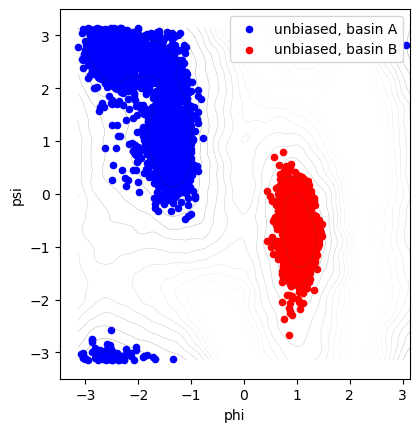

In [3]:
fig, ax = plt.subplots()

plot_isolines_AlDi([ax])
ax.set_xlabel('$\phi$')
ax.set_ylabel('$\psi$')

folder = '/Volumes/mySSD/data/paper/alanine/'
colvarA = load_dataframe(folder+'opes/Colvar_A')
colvarA['label'] = np.full(len(colvarA), 0)
colvarB = load_dataframe(folder+'opes/Colvar_B')
colvarB['label'] = np. full(len(colvarB), 1)
colvar_ub = pd.concat([colvarA, colvarB], ignore_index=True)

colvarA.plot.scatter('phi', 'psi', c='b', ax=ax, label='unbiased, basin A')
colvarB.plot.scatter('phi', 'psi', c='r', ax=ax, label='unbiased, basin B')
ax.set_aspect('equal')
ax.legend()

## Initial DeepTDA CV

In [4]:
# shuffle
sample_colvar = colvar_ub.sample(frac=1)

X = torch.Tensor(sample_colvar.filter(regex='d[1-9]').values)
y = torch.Tensor(sample_colvar['label'].values)

ntrain = int(0.8*len(X))

train_data = [X[:ntrain], y[:ntrain]]
valid_data = [X[ntrain:], y[ntrain:]]

train_loader = FastTensorDataLoader(train_data)
valid_loader = FastTensorDataLoader(valid_data)

n_features = X.shape[1]
layers = [n_features, 24, 12]
n_states = 2
n_cv = 1

mu_tg = [-7., 7.]
sig_tg = [0.2, 0.2]

model_1 = DeepTDA_CV(layers, n_states, n_cv, mu_tg, sig_tg)
model_1.set_earlystopping(patience=15)
model_1.fit(train_loader, valid_loader, log_every=10, nepochs=3000)
# model_1.export(folder, traced_name='model_tda1.ptc')

epoch           loss_train      loss_valid      
10              107.972         107.955         
20              103.665         103.648         
30              100.619         100.612         
40              98.924          98.935          
50              97.319          97.344          
60              95.598          95.590          
70              93.622          93.598          
80              91.068          91.023          
90              87.809          87.746          
100             83.686          83.616          
110             78.584          78.550          
120             72.454          72.517          
130             65.535          65.713          
140             58.096          58.316          
150             50.733          50.884          
160             43.556          43.617          
170             36.663          36.669          
180             30.533          30.497          
190             25.115          25.126          
200             20.3

(<Figure size 600x500 with 2 Axes>,
 [<matplotlib.axes._subplots.AxesSubplot at 0x42c9b32d0>])

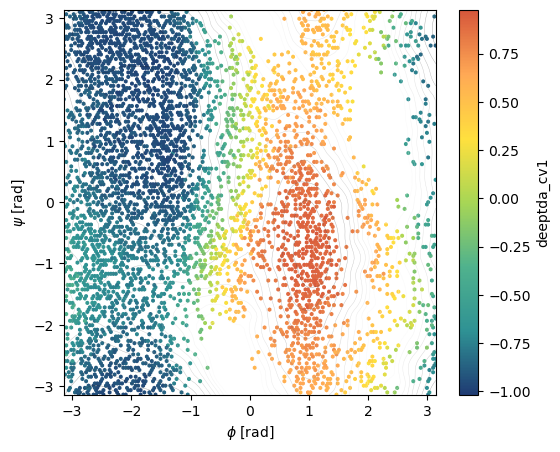

In [5]:
plot_cv_ramachandran(model=model_1, draw_iso=True)

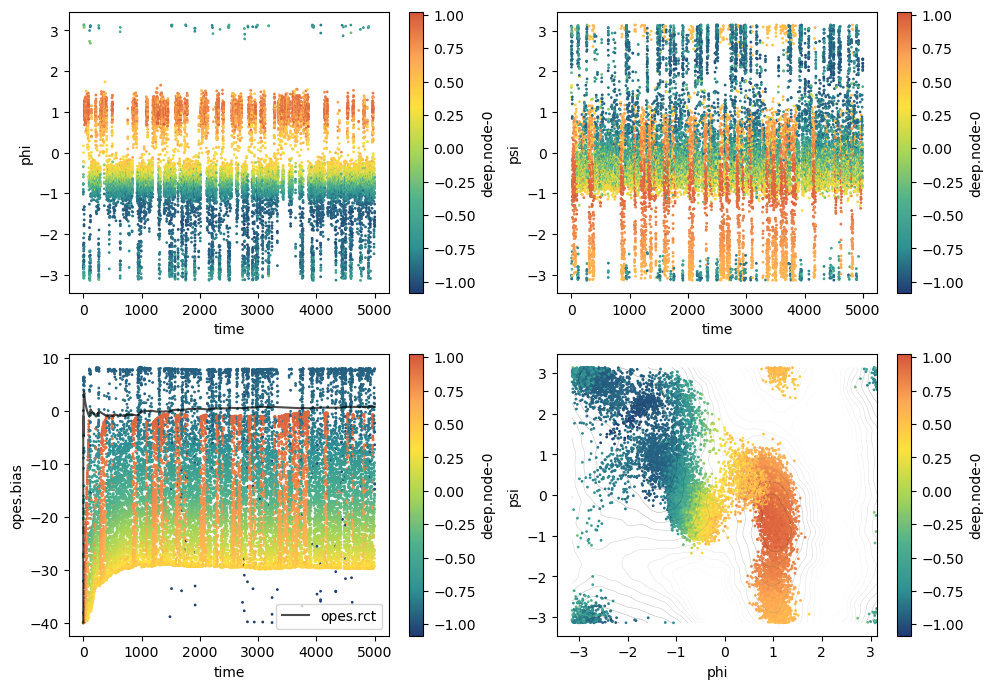

number of total transitions between states:  100.0


100.0

In [6]:
%matplotlib inline
colvar_tda1 = load_dataframe(folder+'opes/Colvar_tda1')
plot_opes(colvar_tda1, lx='phi', ly='psi', iso='ala')

state_ext = np.array([[[-2.62,-0.52],[0., np.pi]], [[0.52, 2.27],[-np.pi, 0.]]])
transition_histogram(colvar_tda1[['phi', 'psi']], state_ext, plot=False)

In [7]:
%matplotlib inline
pfolder = '/Volumes/mySSD/data/paper/alanine/mdop/'
mdop_path = pfolder+'mdop_alanine_N512_tda_B80_ft_2_colvar/'
ppath = pfolder+'paths_alanine_N512_tda_B80_ft_2/'
convert = False

if convert:
    path_data_1 = convert_colvar(mdop_path, ppath, write_biasfile=False)
else:
    skip = 0 # number of paths to skip
    files = sorted(os.listdir(ppath), key = lambda x: int(x.split('.')[-1]))[skip:]
    path_data_1 = read_paths(ppath, files)

lx = 'phi'
ly = 'psi'
cvname = 'deep.node-0'
n_beads = len(path_data_1[path_data_1['path_id'] == path_data_1['path_id'][0]])
n_paths = len(path_data_1['path_id'].unique())

Reading paths...


100%|██████████| 4000/4000 [01:02<00:00, 64.09it/s]


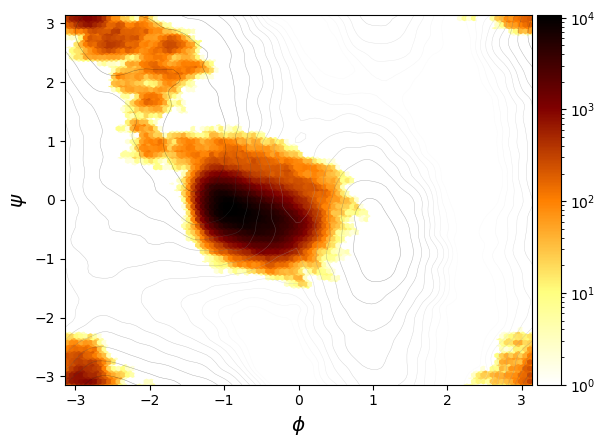

In [8]:
# fig, ax = plt.subplots(1, 2, figsize=(10,4), dpi=100)
_,ax = plt.subplots()
plot_paths(path_data_1, xplabel='$\phi$', yplabel='$\psi$', ax=ax, cmap='afmhot_r', bins='log')
# plot_paths(path_data_1, C='deep.node-0', ax=ax[1], cmap='fessa')
# plot_paths(path_data_1, C='s', ax=ax[1], cmap='fessa')
plot_isolines_AlDi(ax)

In [9]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
%matplotlib notebook

gridx, gridy, fes = np.loadtxt('reference_fes/fes.dat', skiprows=1, delimiter=' ', unpack=True)
gridx = gridx.reshape((int(np.sqrt(len(gridx))), -1))
gridy = gridy.reshape((int(np.sqrt(len(gridy))), -1))
fes = fes.reshape((int(np.sqrt(len(fes))), -1))
levels = np.arange(np.min(fes), 70, 10)
contour = plt.contour(gridx, gridy, fes, levels=levels, linewidths=.5, alpha=.5, colors='black')

# animate
fig, ax = plt.subplots()
def ani_func(frame):
    ax.clear()
    ax.set_title('Path #'+str(frame))
    ax.set_xlabel('phi')
    ax.set_ylabel('psi')
    ax.contour(contour)
    traj = path_data_1.groupby('path_id').get_group(frame)
    ax.plot(traj['phi'], traj['psi'], marker='.', ms=1, linewidth=.7)

fps = 6
ani = FuncAnimation(fig, ani_func, frames=path_data_1['path_id'].unique()[::100], interval=1./fps*1000)
# ani.save('paper/alanine/figures/paths_N256_gm_anim.gif', writer='pillow', fps=fps)
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

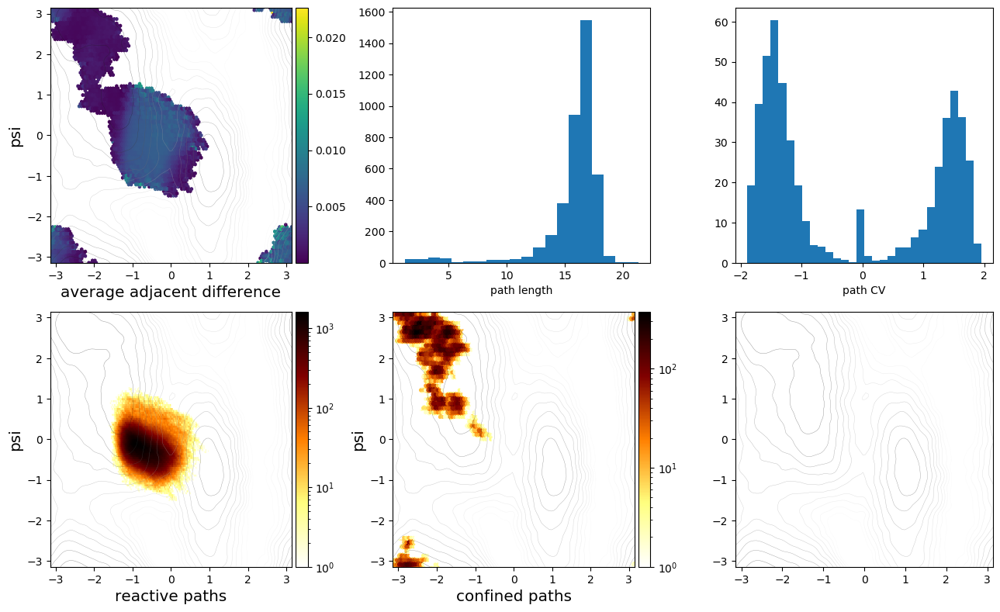

In [10]:
%matplotlib inline
# analysing paths
cvname='deep.node-0'
fig, axs = plt.subplots(2, 3, figsize=(13, 8), dpi=100)
axs = axs.flatten()

avg_diff = calc_average_distance(path_data_1, labels=[cvname], plot_labels=[lx,ly], kernel_size=15)
plot_paths(avg_diff, lx, ly, 'average adjacent difference', C='dist', ax=axs[0])

path_lens = calc_path_lengths(path_data_1, labels=[cvname])
# add path length to dataframe
for i, l in path_lens:
    path_data_1.loc[path_data_1['path_id'] == i, 'path_length'] = l
axs[1].hist(path_lens[:,1], bins=20)
axs[1].set_xlabel('path length')

axs[2].hist(path_data_1['CV'], bins=30, weights=np.full(len(path_data_1['CV']), 1./n_paths))
axs[2].set_xlabel('path CV')

reactive = path_data_1[path_data_1['CV'].abs() >= 1.2]
plot_paths(reactive, lx, ly, 'reactive paths', ax=axs[3], bins='log', cmap='afmhot_r')

confined = path_data_1[path_data_1['CV'].abs() <= 0.3]
plot_paths(confined, lx, ly, 'confined paths', ax=axs[4], bins='log', cmap='afmhot_r')

# filter paths by length/completeness/bias
# filter_ids = []
# for _, df in path_data_1.groupby('path_id'):
#     if np.any((df[lx] >= 0.8) & (df[ly] >= 1.1)) & np.any((df[lx] <= -0.2) & (df[ly] >= 1.2)):
#         filter_ids.append(df['path_id'].iloc[0])
# filter_ids = np.unique(filter_ids)
# filter_paths = path_data_1[path_data_1['path_id'].isin(filter_ids)]

# for _,p in filter_paths.groupby('path_id'):
#     axs[5].plot(p[lx], p[ly])
# # plot_paths(filter_paths, lx, ly, 'filtered paths', ax=axs[5], bins='log', cmap='afmhot_r')
# print('# of filtered paths:', len(filter_paths)/n_beads)

plot_isolines_AlDi(axs[[0,3,4,5]])
plt.tight_layout()

4001
4001
4001


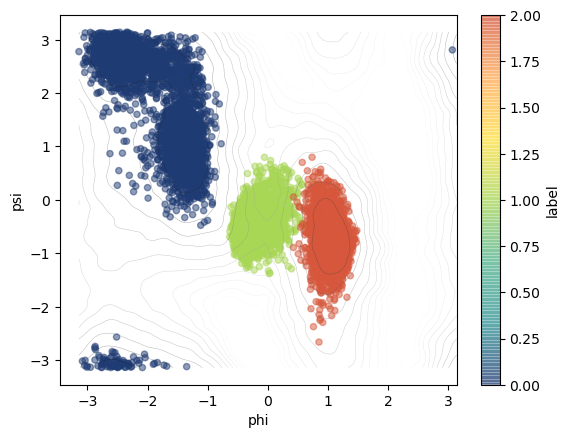

In [11]:
%matplotlib inline
# remove configurations within basins
# colvar_int = reactive[reactive['phi'].between(-0.6, 1.)]
colvar_int = reactive[reactive['deep.node-0'] > 0.3]
colvar_int = colvar_int.sample(int(1*len(colvarA)))
colvar_int['label'] = np.full(len(colvar_int), 1)
colvarB['label'] = np.full(len(colvarB), 2)
print(len(colvarA))
print(len(colvar_int))
print(len(colvarB))
colvar_2 = pd.concat([colvarA, colvar_int, colvarB])
_, ax = plt.subplots()
colvar_2.plot.scatter(lx, ly, c='label', ax=ax, alpha=0.5, cmap='fessa')
plot_isolines_AlDi(ax)

In [12]:
# shuffle 
sample_colvar = colvar_2.sample(frac=1)
X = torch.Tensor(sample_colvar.filter(regex='d[1-9]').values)
y = torch.Tensor(sample_colvar['label'].values)

ntrain = int(0.8*len(X))

train_data = [X[:ntrain], y[:ntrain]]
valid_data = [X[ntrain:], y[ntrain:]]

train_loader = FastTensorDataLoader(train_data)
valid_loader = FastTensorDataLoader(valid_data)

n_features = X.shape[1]
layers = [n_features, 24, 12]
n_states = 3
n_cv = 1

mu_tg = [-7., 0., 7.]
sig_tg = [0.3, 1., 0.3]

model_2 = DeepTDA_CV(layers, n_states, n_cv, mu_tg, sig_tg)
model_2.set_earlystopping(patience=15)
model_2.fit(train_loader, valid_loader, log_every=10, nepochs=3000)
model_2.export(folder+'models/', traced_name='model_tda3st_tda_seltst.ptc')

epoch           loss_train      loss_valid      
10              352.963         352.559         
20              325.555         324.939         
30              288.100         287.448         
40              244.331         243.376         
50              200.004         198.426         
60              164.061         162.239         
70              142.352         140.683         
80              130.669         128.919         
90              121.686         119.697         
100             113.031         111.025         
110             105.204         103.338         
120             98.576          96.990          
130             93.378          92.154          
140             89.538          88.639          
150             86.511          85.847          
160             83.830          83.315          
170             81.172          80.716          
180             78.350          77.911          
190             75.279          74.814          
200             71.9

(<Figure size 600x500 with 2 Axes>,
 [<matplotlib.axes._subplots.AxesSubplot at 0x42da0a450>])

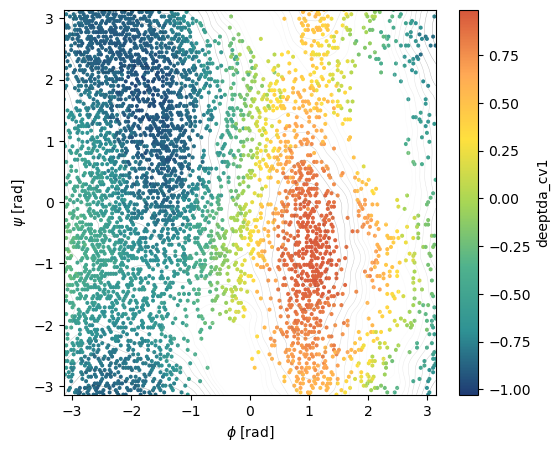

In [13]:
plot_cv_ramachandran(model=model_2, draw_iso=True)

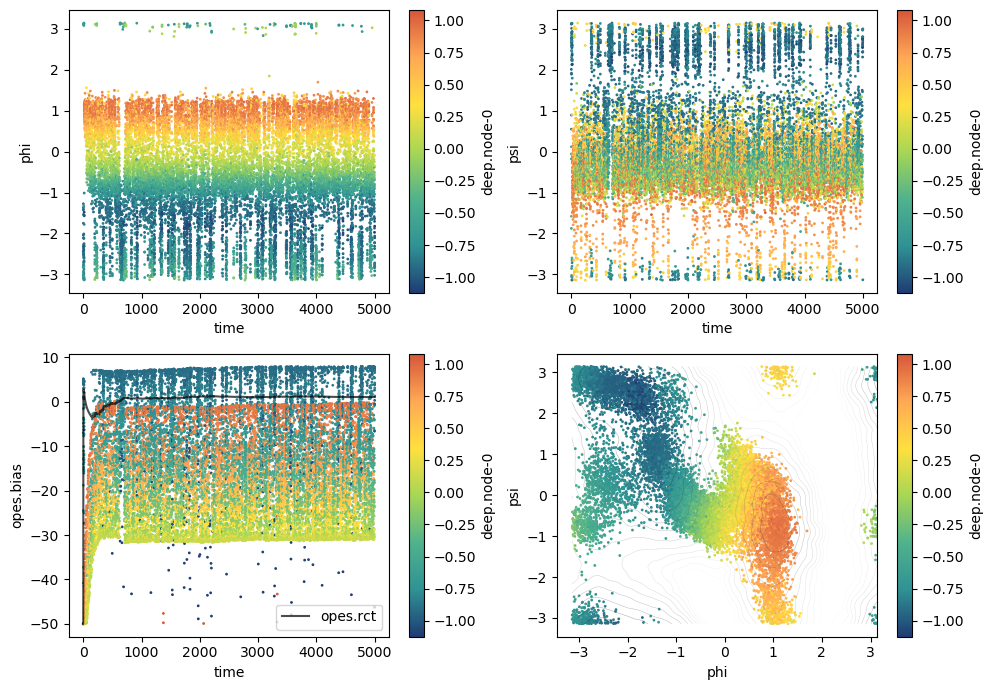

number of total transitions between states:  492.0


492.0

In [14]:
colvar_tda2 = load_dataframe(folder+'opes/colvar_ala_tda3st_seltst')
plot_opes(colvar_tda2, lx='phi', ly='psi', iso='ala')
transition_histogram(colvar_tda2[['phi', 'psi']], state_ext, plot=False)

## 3-state DeepTDA CV

In [15]:
pfolder = '/Volumes/mySSD/data/paper/alanine/mdop/'
mdop_path = pfolder+'mdop_alanine_N512_tda3st_2dcv_colvar/'
ppath = pfolder+'paths_alanine_N512_tda3st_tst/'
convert = False

if convert:
    path_data_2 = convert_colvar(mdop_path, ppath, write_biasfile=False)
else:
    skip = 0 # number of paths to skip
    files = sorted(os.listdir(ppath), key = lambda x: int(x.split('.')[-1]))[skip:]
    files = [f for f in files if f.split('.')[0]=='path'] # remove weird file names
    path_data_2 = read_paths(ppath, files)

lx = 'phi'
ly = 'psi'
cvname = 'deep.node-0'
n_beads = len(path_data_2[path_data_2['path_id'] == path_data_2['path_id'][0]])
n_paths = len(path_data_2['path_id'].unique())

Reading paths...


100%|██████████| 3000/3000 [00:46<00:00, 64.85it/s]


In [85]:
# add remaining paths from continued simulation
# mdop_path = pfolder+'mdop_alanine_N512_tda3st_2dcv_restart/'
# ppath = pfolder+'paths_alanine_N512_tda3st_2dcv_restart/'
# convert = True
# if convert:
#     cont_data = convert_colvar(mdop_path, ppath, write_biasfile=False)
# else:
#     skip = 0 # number of paths to skip
#     files = sorted(os.listdir(ppath), key = lambda x: int(x.split('.')[-1]))[skip:]
#     files = [f for f in files if f.split('.')[0]=='path'] # remove weird file names
#     cont_data = read_paths(ppath, files)
# path_data_2.append(cont_data)
# n_paths = len(path_data_2['path_id'].unique())

Loading metaD of Paths Colvars...


100%|██████████| 512/512 [00:41<00:00, 12.25it/s]


Writing path Colvars...


100%|██████████| 2000/2000 [02:08<00:00, 15.53it/s]


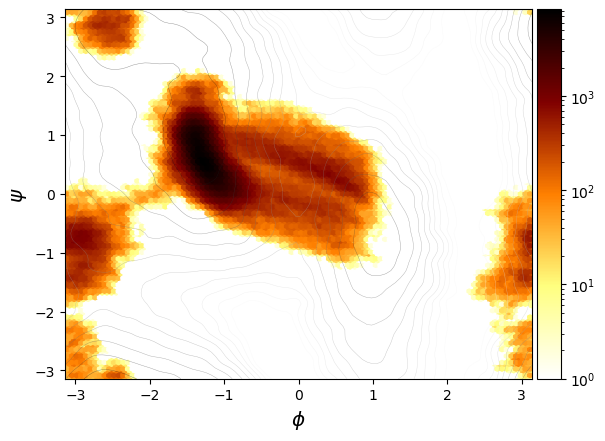

In [16]:
%matplotlib inline
# fig, ax = plt.subplots(1, 2, figsize=(10,4), dpi=100)
_,ax = plt.subplots()
plot_paths(path_data_2, xplabel='$\phi$', yplabel='$\psi$', ax=ax, cmap='afmhot_r', bins='log')
# plot_paths(path_data_2, C='deep.node-0', ax=ax[1], cmap='fessa')
plot_isolines_AlDi(ax)

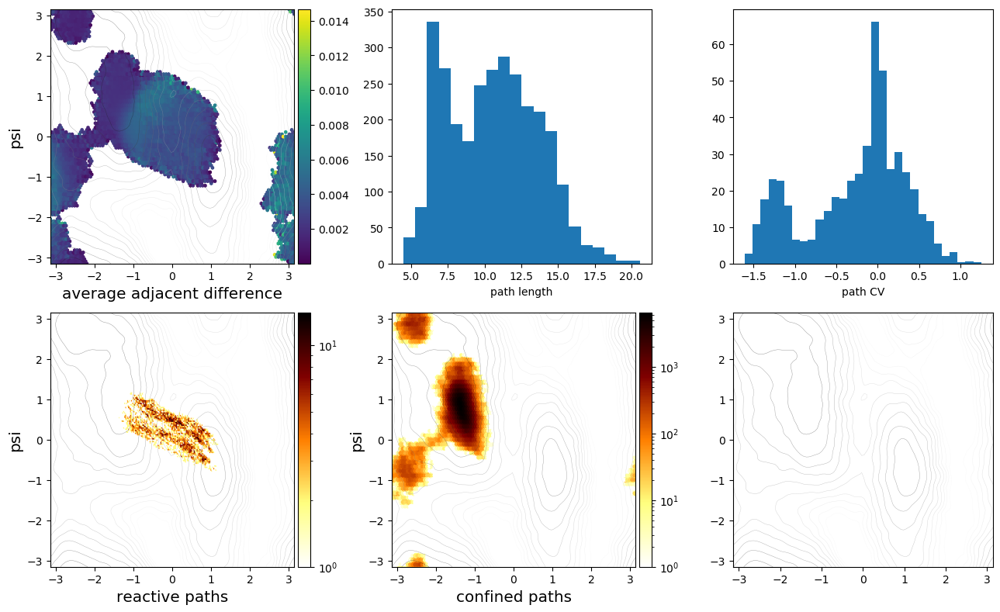

In [17]:
%matplotlib inline
# analysing paths
cvname='deep.node-0'
fig, axs = plt.subplots(2, 3, figsize=(13, 8), dpi=100)
axs = axs.flatten()

avg_diff = calc_average_distance(path_data_2, labels=[cvname], plot_labels=[lx,ly], kernel_size=15)
plot_paths(avg_diff, lx, ly, 'average adjacent difference', C='dist', ax=axs[0])

path_lens = calc_path_lengths(path_data_2, labels=[cvname])
# add path length to dataframe
for i, l in path_lens:
    path_data_2.loc[path_data_2['path_id'] == i, 'path_length'] = l
axs[1].hist(path_lens[:,1], bins=20)
axs[1].set_xlabel('path length')

axs[2].hist(path_data_2['CV'], bins=30, weights=np.full(len(path_data_2['CV']), 1./n_paths))
axs[2].set_xlabel('path CV')

reactive = path_data_2[path_data_2['CV'].abs() >= 1.5]
plot_paths(reactive, lx, ly, 'reactive paths', ax=axs[3], bins='log', cmap='afmhot_r')

confined = path_data_2[path_data_2['CV'].abs() <= 0.3]
plot_paths(confined, lx, ly, 'confined paths', ax=axs[4], bins='log', cmap='afmhot_r')

plot_isolines_AlDi(axs[[0,3,4,5]])
plt.tight_layout()

In [77]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
%matplotlib notebook

gridx, gridy, fes = np.loadtxt('reference_fes/fes.dat', skiprows=1, delimiter=' ', unpack=True)
gridx = gridx.reshape((int(np.sqrt(len(gridx))), -1))
gridy = gridy.reshape((int(np.sqrt(len(gridy))), -1))
fes = fes.reshape((int(np.sqrt(len(fes))), -1))
levels = np.arange(np.min(fes), 70, 10)
contour = plt.contour(gridx, gridy, fes, levels=levels, linewidths=.5, alpha=.5, colors='black')

# animate
fig, ax = plt.subplots()
def ani_func(frame):
    ax.clear()
    ax.set_title('Path #'+str(frame))
    ax.set_xlabel('phi')
    ax.set_ylabel('psi')
    ax.contour(contour)
    traj = path_data_2.groupby('path_id').get_group(frame)
    ax.plot(traj['phi'], traj['psi'], marker='.', ms=1, linewidth=.7)

fps = 6
ani = FuncAnimation(fig, ani_func, frames=path_data_2['path_id'].unique()[::50], interval=1./fps*1000)
# ani.save('paper/alanine/figures/paths_N256_gm_anim.gif', writer='pillow', fps=fps)
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Path CV

In [90]:
%matplotlib inline
# filter_ids = []
# for _, df in path_data_1.groupby('path_id'):
#     if is_reactive(df)[0]:
#         filter_ids.append(df['path_id'].iloc[0])
# filter_ids = np.unique(filter_ids)
filter_ids = reactive['path_id'].unique()

filter_paths = path_data_2[path_data_2['path_id'].isin(filter_ids)]

# _, ax = plt.subplots()
# plot_paths(filter_paths, lx, ly, 'filtered paths', ax=ax, bins='log', cmap='afmhot_r')
print('# of filtered paths:', len(filter_paths)/n_beads)

# of filtered paths: 20.0


[1726]


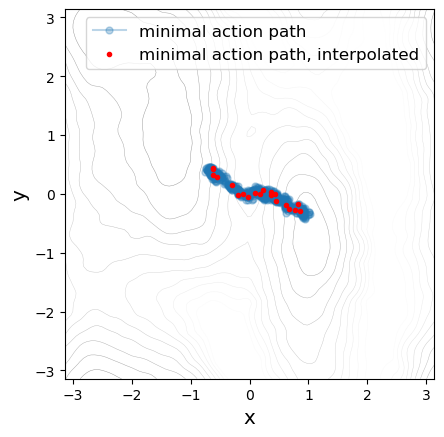

In [76]:

# take only every other config
# min_path = filter_paths.loc[filter_paths['path_id'] == filter_paths['path_id'].unique()[0]]
min_path = filter_paths.loc[np.isclose(filter_paths['ene'], filter_paths['ene'].min())]
if len(min_path['path_id'].unique()) > 0:
    min_path = min_path.loc[min_path['path_id'] == min_path['path_id'].unique()[0]]
print(min_path['path_id'].unique())
idx = np.linspace(0, n_beads-1, 20, dtype=int)
phi, psi = min_path[['phi', 'psi']].values[idx].T

fig = plt.figure()
ax = fig.add_subplot(111) #121
ax.plot(min_path[lx], min_path[ly], 'o-', alpha=0.3, markersize=5, label='minimal action path')
ax.plot(phi, psi, 'ro', markersize=3, label='minimal action path, interpolated')
ax.set_xlabel('x', fontsize='x-large')
ax.set_ylabel('y', fontsize='x-large')
ax.set_aspect('equal')
ax.legend(fontsize='large')
plot_isolines_AlDi(ax)

# fname ='reactive_path.pdb'
# with open(folder+fname, 'w') as file:
#     for x,y in zip(phi,psi):
#         # line =  "REMARK EUCLIDEAN\n"
#         line = "REMARK ARG=phi,psi\n"
#         line += "REMARK phi={:<8.3f} psi={:<8.3f}\n".format(x, y)
#         line += "END\n"
#         file.write(line)
#     print('Reference path written to '+folder+fname)

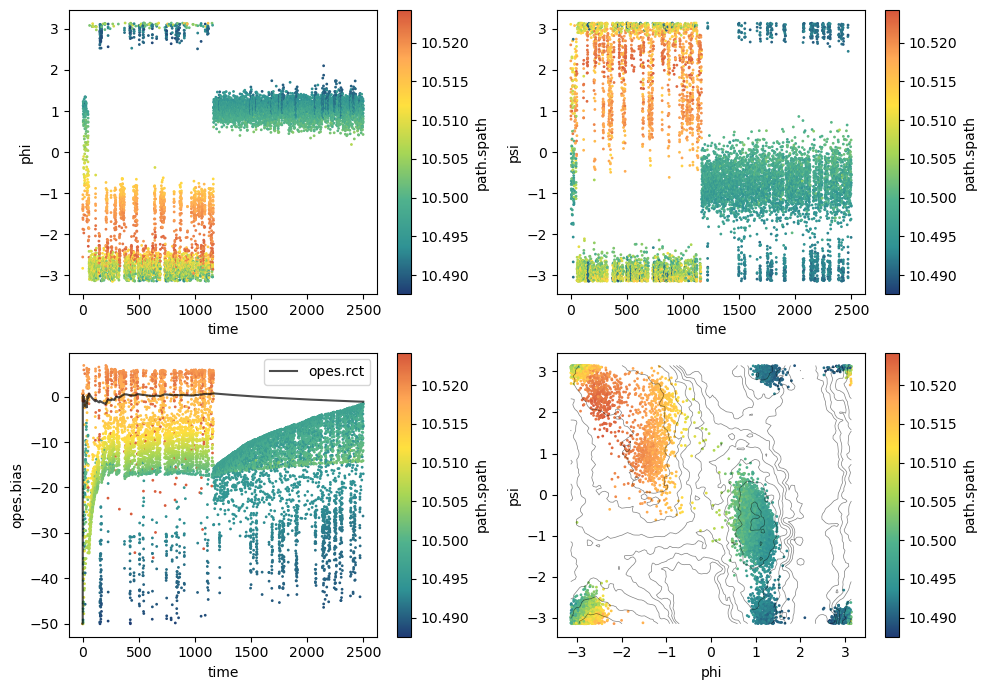

number of total transitions between states:  9.0


9.0

In [39]:
%matplotlib inline
colvar_pcv = load_dataframe(folder+'opes/Colvar_pcv')
plot_opes(colvar_pcv, lx='phi', ly='psi', cvname='path.spath', iso='ala')
transition_histogram(colvar_pcv[['phi', 'psi']], state_ext, plot=False)